In [17]:
#导入所需模块
import numpy as np
import os
import cv2
from collections import Counter
import matplotlib.pyplot as plt

In [18]:
def histogram_equalization(image):

    # 计算直方图
    hist, bins = np.histogram(image.flatten(), 256, [0, 256])

    # 计算累积直方图
    cdf = hist.cumsum()
    cdf_normalized = cdf * float(hist.max()) / cdf.max()

    # 创建映射表
    cdf_m = np.ma.masked_equal(cdf, 0)
    cdf_m = (cdf_m - cdf_m.min()) * 255 / (cdf_m.max() - cdf_m.min())
    cdf = np.ma.filled(cdf_m, 0).astype('uint8')

    # 应用映射表
    equalized_image = cdf[image]

    return equalized_image

# 导入训练图片

1、读取图片

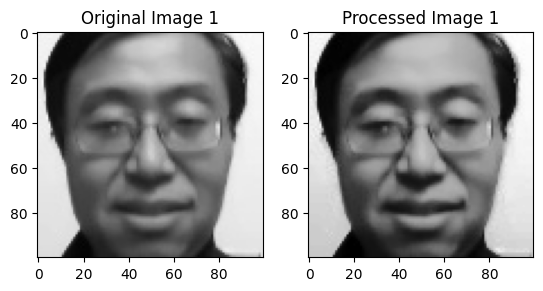

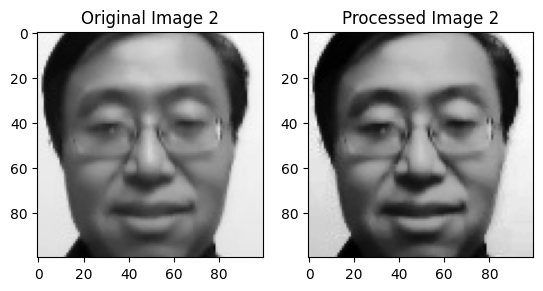

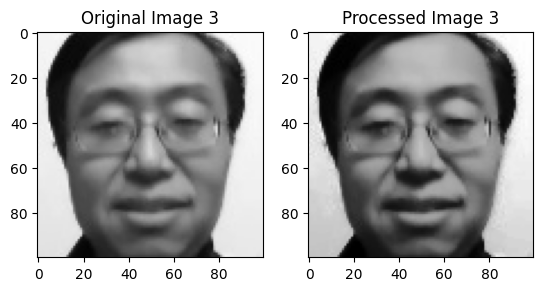

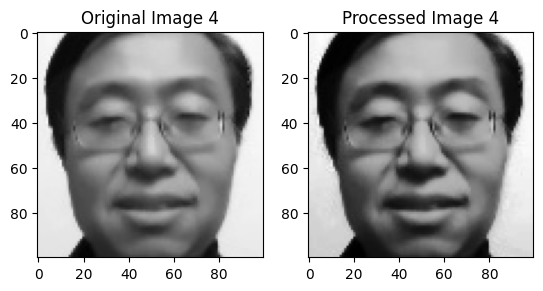

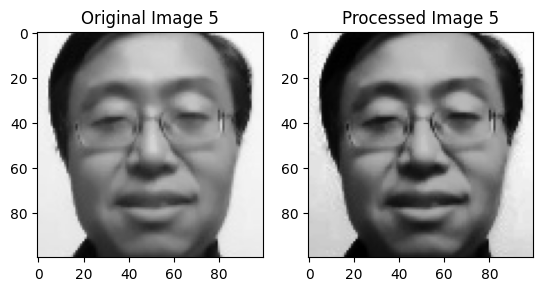

...

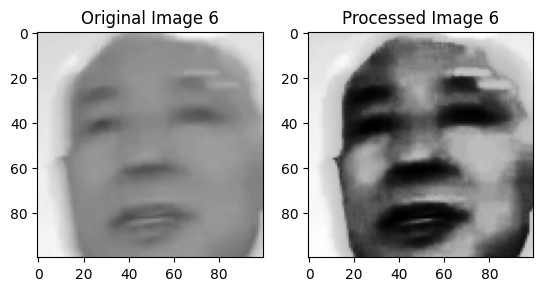

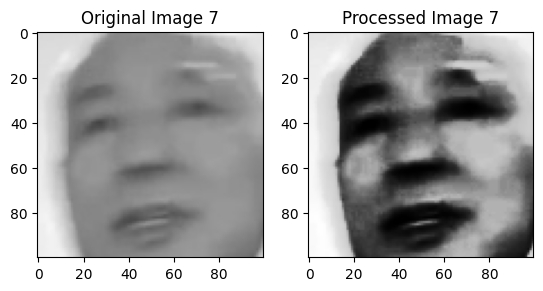

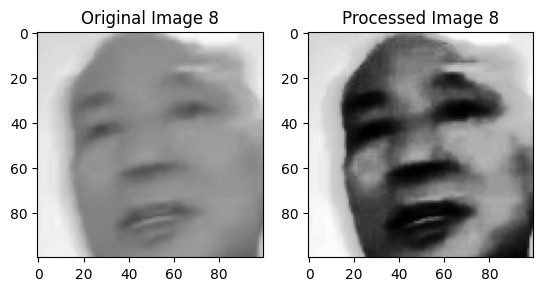

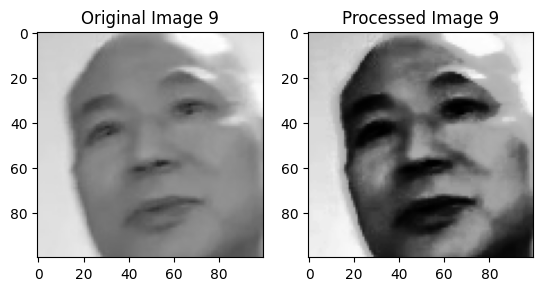

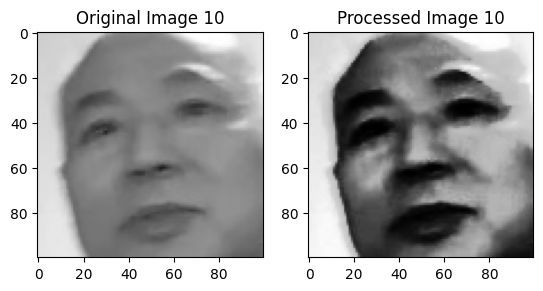

In [19]:
# 返回的是480张100*100的矩阵，和index
listdir = os.listdir('./face_train')
names = [d for d in listdir if not d.startswith('.')]
images = []
target = []
for index,dir in enumerate(names):
    for i in range(1, 11):
        gray = cv2.imread('./face_train/%s/%d.jpg' % (dir, i))  # 三维图片
        
        #图像均衡化
        gray_equalized = histogram_equalization(gray)
        
        # Display both original and processed images side by side
        plt.subplot(1, 2, 1)  # First subplot
        plt.imshow(gray)
        plt.title(f"Original Image {i}")

        plt.subplot(1, 2, 2)  # Second subplot
        plt.imshow(gray_equalized, cmap='gray')  # Display in grayscale
        plt.title(f"Processed Image {i}")

        plt.show()  # Show the combined plot
        
        gray_ = gray_equalized[:, :, 0]  # 二维数组
        gray_ = cv2.resize(gray_, dsize=(100, 100))
        images.append(gray_)
        target.append(index)
images = np.asarray(images)
target = np.asarray(target)

2、转换成矩阵

In [20]:
#图像数据转换特征矩阵
image_data = []

for image in images:
    #转换成一维的数组
    data = image.flatten()
    image_data.append(data)

#print(image_data)

In [21]:
#转换为numpy数组
X_train = np.array(image_data)
y_train = target
print(type(X_train))
print(X_train.shape)
print(X_train)

<class 'numpy.ndarray'>
(200, 10000)
[[243 250 245 ... 186 158 199]
 [244 250 248 ... 213 213 213]
 [243 243 243 ... 195 196 204]
 ...
 [212 212 212 ...  79 193 201]
 [191 191 191 ...  34  74 127]
 [211 211 211 ...  14  17  22]]


# 导入测试向量

In [22]:
listdir_test = os.listdir('./face_test')
names_test = [d for d in listdir_test if not d.startswith('.')]
print(names_test)
images_test = []
target_test = []
for index_test,dir_test in enumerate(names_test):
    for i in range(1, 31):
        gray_test = cv2.imread('./face_test/%s/%d.jpg' % (dir_test, i))  # 三维图片
        
        #图像均衡化
        gray_test_equalized = histogram_equalization(gray_test)
        
        gray_test_ = gray_test_equalized[:, :, 0]  # 二维数组
        gray_test_ = cv2.resize(gray_test_, dsize=(100, 100))
        
        images_test.append(gray_test_)
        target_test.append(index_test)
images_test = np.asarray(images_test)
target_test = np.asarray(target_test)

['Chen Aijun', 'Chen Jiayin', 'Dong Yini', 'Dong Zhiyong', 'Gao Yiqing', 'Jiang Letian', 'Li Baoyan', 'Li Xiufang', 'Liu Jianhua', 'Liu Mingzhen', 'Lv Hui', 'Wu Di', 'Wu Leru', 'Yu Bin', 'Yu Di', 'Yu Hong', 'Yu Shaozhou', 'Yu Wei', 'Yu Ying', 'Zheng Ruojun']


In [23]:
#图像数据转换特征矩阵
image_data_test = []

for image_test in images_test:
    #转换成一维的数组
    data_test = image_test.flatten()
    image_data_test.append(data_test)

#print(image_data)

In [24]:
#转换为numpy数组
X_test = np.array(image_data_test)
y_test = target_test
print(type(X_test))
print(X_test.shape)

<class 'numpy.ndarray'>
(600, 10000)


# 对训练集进行预处理

In [25]:
# 对数据进行中心化，即每一列减去该列的均值
X_train_centered = X_train - np.mean(X_train, axis=0)

In [26]:
# 主成分数量
k = 100
# 对训练矩阵进行SVD
U, S, Vt = np.linalg.svd(X_train_centered, full_matrices=False)
# 选择前100个主成分
X_train_pca = U[:, :k]
# 构建变换矩阵P
P = np.dot(X_train.T, X_train_pca)
print(P)

[[-2.41937190e+02 -8.33315987e+01 -2.05164004e+02 ... -3.64924770e+00
   3.34063307e+00 -2.46692790e+00]
 [-3.46914288e+02 -1.61265508e+02 -2.36464779e+02 ...  1.30922526e+01
  -1.11345452e+01 -1.88221905e+01]
 [-4.61506429e+02 -2.24270100e+02 -2.13278374e+02 ... -5.42448327e+00
   7.42002786e-01 -1.73155215e+01]
 ...
 [-8.27276244e+02 -3.64422213e+02 -2.39993616e+02 ... -5.09180406e+00
  -1.43875951e+01  4.08727643e+01]
 [-7.69798771e+02 -4.15184129e+02 -2.20611336e+02 ...  1.14341731e+01
  -3.23972705e+01  5.73801333e+01]
 [-7.33773325e+02 -4.07356797e+02 -2.66366008e+02 ...  1.70240417e+01
  -3.47736668e+01 -2.40345741e+01]]


# k-NNR进行人脸识别

1、用numpy函数

In [27]:
true_count = 0

In [28]:
# 计算每个测试数据和训练数据之间的欧几里得范数
for i in range(len(X_test)):
    test_vector = X_test[i]
    
    # 归一化测试向量
    test_vector = test_vector - np.mean(test_vector, axis=0)

    # 对测试向量PCA
    test_vector = np.dot(test_vector,P)
    
    
    # 初始化一个列表来存储每个训练向量与当前测试向量的欧几里得范数
    distances = []
    
    for j in range(len(X_train_pca)):
        train_vector = X_train_pca[j]
        
        dist = np.sqrt(np.sum((train_vector-test_vector) ** 2))
        distances.append(dist)
    
    # 找到最近的k个邻居
    nearest_indices = np.argsort(distances)[:4]
    
    # 找到最频繁的索引
    counts = Counter(nearest_indices//10 + 1)
    most_common_index = counts.most_common(1)[0][0]
    
    # 检查索引是否相同
    if most_common_index == (i // 30) +1:
        true_count += 1
        print(i)

8
9
10
11
13
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277
278
279
280
281
282
283
28

In [29]:
print(f"The number of True：{true_count}")
print(f"Accuracy with Histogram Equalization：{true_count/(len(X_test))}")

The number of True：569
Accuracy with Histogram Equalization：0.9483333333333334
